In [1]:
pip install librosa

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import IPython
import soundfile as sf
from scipy.stats import ttest_ind, levene

In [3]:
IPython.display.Audio(".\Audios\SPIRIT  Taurus (Instrumental).mp3")

In [4]:
IPython.display.Audio(".\Audios\Led Zeppelin - Stairway To Heaven - Instrumental.mp3")

In [5]:
IPython.display.Audio(".\Audios\Queen instrumental - Under Pressure.mp3")

In [6]:
IPython.display.Audio(".\Audios\Ice Ice Baby WITHOUT vocals.mp3")

In [7]:
#Leemos los audios
audio_Spirit, sr_Spirit = librosa.load(".\Audios\SPIRIT  Taurus (Instrumental).mp3")
audio_Stairway, sr_Stairway = librosa.load(".\Audios\Led Zeppelin - Stairway To Heaven - Instrumental.mp3")
audio_UnderPressure, sr_UnderPressure = librosa.load(".\Audios\Queen instrumental - Under Pressure.mp3")
audio_IceIce, sr_IceIce = librosa.load(".\Audios\Ice Ice Baby WITHOUT vocals.mp3")

In [8]:
#Recortamos los audios de cada canción
segundo_inicio = 51
segundo_fin = 75

inicio = int(segundo_inicio * sr_Spirit)
fin = int(segundo_fin * sr_Spirit)

y_recortado = audio_Spirit[inicio:fin]

recortado_path = '.\Audios\Spirit_Recortado.wav'
sf.write(recortado_path, y_recortado, sr_Spirit)
IPython.display.Audio(recortado_path)


In [9]:
#Recortamos los audios de cada canción
segundo_inicio = 3
segundo_fin = 27

inicio = int(segundo_inicio * sr_Stairway)
fin = int(segundo_fin * sr_Stairway)

y_recortado = audio_Stairway[inicio:fin]

recortado_path = '.\Audios\Stairway_Recortado.wav'
sf.write(recortado_path, y_recortado, sr_Stairway)
IPython.display.Audio(recortado_path)


In [10]:
#Recortamos los audios de cada canción
segundo_inicio = 0.5
segundo_fin = 24.5

inicio = int(segundo_inicio * sr_UnderPressure)
fin = int(segundo_fin * sr_UnderPressure)

y_recortado = audio_UnderPressure[inicio:fin]

recortado_path = './Audios/UnderPressure_Recortado.wav'
sf.write(recortado_path, y_recortado, sr_UnderPressure)
IPython.display.Audio(recortado_path)


In [11]:
#Recortamos los audios de cada canción
segundo_inicio = 0
segundo_fin = 24

inicio = int(segundo_inicio * sr_IceIce)
fin = int(segundo_fin * sr_IceIce)

y_recortado = audio_IceIce[inicio:fin]

recortado_path = './Audios/IceIce_Recortado.wav'
sf.write(recortado_path, y_recortado, sr_IceIce)
IPython.display.Audio(recortado_path)


In [12]:
#Leemos los audios
audio_Spirit, sr_Spirit = librosa.load("./Audios/Spirit_Recortado.wav")
audio_Stairway, sr_Stairway = librosa.load("./Audios/Stairway_Recortado.wav")
audio_UnderPressure, sr_UnderPressure = librosa.load("./Audios/UnderPressure_Recortado.wav")
audio_IceIce, sr_IceIce = librosa.load("./Audios/IceIce_Recortado.wav")

In [13]:
def Grafica_Amplitud(audio1, sr1, audio2, sr2, title1, title2):
    # Crear una figura y ejes
    plt.figure(figsize=(14, 6))

    # Graficar la forma de onda de la primera canción
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(audio1, sr=sr1, alpha=0.5)
    plt.title(title1)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')

    # Graficar la forma de onda de la segunda canción
    plt.subplot(2, 1, 2)
    librosa.display.waveshow(audio2, sr=sr2, alpha=0.5, color='r')
    plt.title(title2)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')

    # Mostrar la gráfica
    plt.tight_layout()
    plt.show()

In [14]:
def Grafica_MFCC(audio1, sr1, audio2, sr2, title1, title2):
        # Crear una figura y ejes
    plt.figure(figsize=(14, 6))
    mfccs = librosa.feature.mfcc(y=audio1, sr=sr1, n_mfcc=13)

    # Graficar la forma de onda de la primera canción
    plt.subplot(2, 1, 1)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.title(title1)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Coeficientes MFCC')
    plt.colorbar(format='%+2.0f dB')

    # Graficar la forma de onda de la segunda canción
    plt.subplot(2, 1, 2)    
    mfccs = librosa.feature.mfcc(y=audio2, sr=sr2, n_mfcc=13)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.title(title2)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Coeficientes MFCC')
    plt.colorbar(format='%+2.0f dB')

    # Mostrar la gráfica
    plt.tight_layout()
    plt.show()

In [15]:
def Grafica_Espectograma(audio1, sr1, audio2, sr2, title1, title2):

    S = librosa.stft(audio1)
    S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
    
    # Crear una figura y ejes
    plt.figure(figsize=(14, 6))

    # Graficar la forma de onda de la primera canción
    plt.subplot(2, 1, 1)
    librosa.display.specshow(S_db, sr=sr1, x_axis='time', y_axis='log')
    plt.title(title1)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Frecuencia (Hz)')
    plt.colorbar(format='%+2.0f dB')

    # Graficar la forma de onda de la segunda canción
    plt.subplot(2, 1, 2)  
    S = librosa.stft(audio2)
    S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
    librosa.display.specshow(S_db, sr=sr2, x_axis='time', y_axis='log')
    plt.title(title2)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Frecuencia (Hz)')
    plt.colorbar(format='%+2.0f dB')

    # Mostrar la gráfica
    plt.tight_layout()
    plt.show()

In [16]:
def Grafica_frecuencias(audio1, sr1, audio2, sr2, title1, title2):
    # Obtener las frecuencias y los tiempos del espectrograma
    frequencies = librosa.fft_frequencies(sr=sr1)  
    S = librosa.stft(audio1)
    S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
    times = librosa.frames_to_time(np.arange(S_db.shape[1]), sr=sr1)

    # Sumar las amplitudes a lo largo del tiempo para cada frecuencia
    sum_amplitudes1 = np.sum(S_db, axis=1)

    # Seleccionar las 10 frecuencias más representativas
    top_n = 30
    top_indices = np.argsort(sum_amplitudes1)[-top_n:][::-1]
    top_frequencies1 = frequencies[top_indices]
    top_amplitudes1 = sum_amplitudes1[top_indices]


    # Obtener las frecuencias y los tiempos del espectrograma
    frequencies = librosa.fft_frequencies(sr=sr2)
    S = librosa.stft(audio2)
    S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
    times = librosa.frames_to_time(np.arange(S_db.shape[1]), sr=sr2)

    # Sumar las amplitudes a lo largo del tiempo para cada frecuencia
    sum_amplitudes2 = np.sum(S_db, axis=1)

    # Seleccionar las 10 frecuencias más representativas
    top_n = 30
    top_indices = np.argsort(sum_amplitudes2)[-top_n:][::-1]
    top_frequencies2 = frequencies[top_indices]
    top_amplitudes2 = sum_amplitudes2[top_indices]

    # Visualizar las frecuencias representativas como líneas
    plt.figure(figsize=(14, 6))
    plt.stem(top_frequencies1, top_amplitudes1, linefmt='b-', markerfmt='bo', basefmt='b-', label=title1)
    plt.stem(top_frequencies2, top_amplitudes2, linefmt='g-', markerfmt='go', basefmt='g-', label=title2)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Amplitud Total (dB)')
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2)
    plt.tight_layout()
    plt.show()

In [17]:
def prueba_varianza(y1, y2, alpha = 0.05):
    amplitudes1 = np.abs(y1)
    amplitudes2 = np.abs(y2)
    stat, p_value = levene(amplitudes1, amplitudes2)
    print(f"Estadístico de Levene: {stat}")
    print(f"P-valor: {p_value}")
    if p_value < alpha:
        print("Las varianzas de las amplitudes son significativamente diferentes.")
    else:
        print("No hay una diferencia significativa en las varianzas de las amplitudes.")

In [18]:
#Prueba de Hipótesis para probar parecidos
def prueba_media(y1, y2, alpha = 0.05):
    amplitud1 = np.abs(y1)
    amplitud2 = np.abs(y2)

    # Realizar la prueba de Levene para comparar las varianzas
    stat, p_value = levene(amplitud1, amplitud2)

    if p_value < alpha:
        t_stat, p_value = ttest_ind(amplitud1, amplitud2, equal_var=False)
    else:
        t_stat, p_value = ttest_ind(amplitud1, amplitud2, equal_var=True)
    

    print(f"T-statistic: {t_stat}")
    print(f"P-value: {p_value}")

    # Interpretación del resultado
    if p_value < alpha:
        print("Hay una diferencia significativa en las amplitudes medias de las dos canciones.")
    else:
        print("No hay una diferencia significativa en las amplitudes medias de las dos canciones.")

In [19]:
def analizar_mfcc(y1, sr1, y2, sr2, alpha = 0.05):
    mfcc1 = librosa.feature.mfcc(y=y1, sr=sr1, n_mfcc=13)
    mfcc2 = librosa.feature.mfcc(y=y2, sr=sr2, n_mfcc=13)

    for i in range(len(mfcc1)):
        t_stat, p_value = ttest_ind(mfcc1[i], mfcc2[i], equal_var=False)
        print(f"MFCC {i+1}: T-statistic: {t_stat}, P-value: {p_value}")
        if p_value < alpha:
            print(f"MFCC {i+1}: Hay una diferencia significativa.")
        else:
            print(f"MFCC {i+1}: No hay una diferencia significativa.")


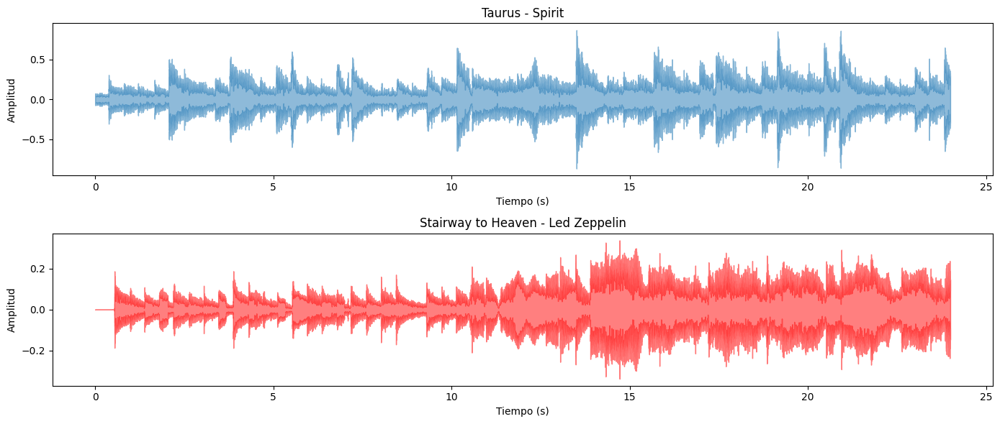

In [20]:
Grafica_Amplitud(audio_Spirit, sr_Spirit, audio_Stairway, sr_Stairway, 'Taurus - Spirit', 'Stairway to Heaven - Led Zeppelin')

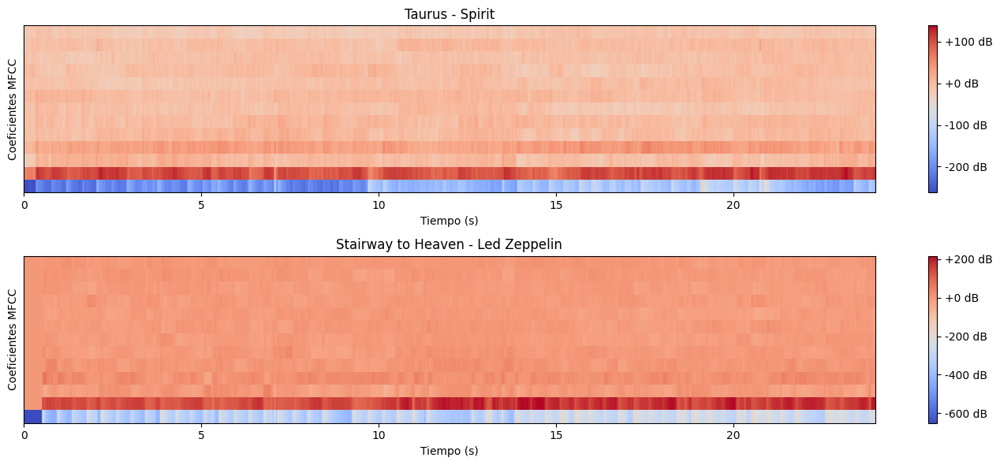

In [21]:
Grafica_MFCC(audio_Spirit, sr_Spirit, audio_Stairway, sr_Stairway, 'Taurus - Spirit', 'Stairway to Heaven - Led Zeppelin')

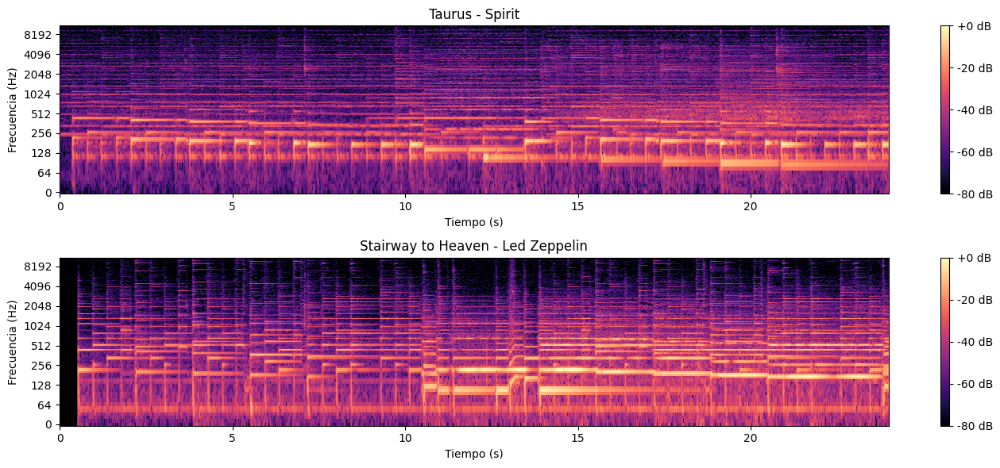

In [22]:
Grafica_Espectograma(audio_Spirit, sr_Spirit, audio_Stairway, sr_Stairway, 'Taurus - Spirit', 'Stairway to Heaven - Led Zeppelin')

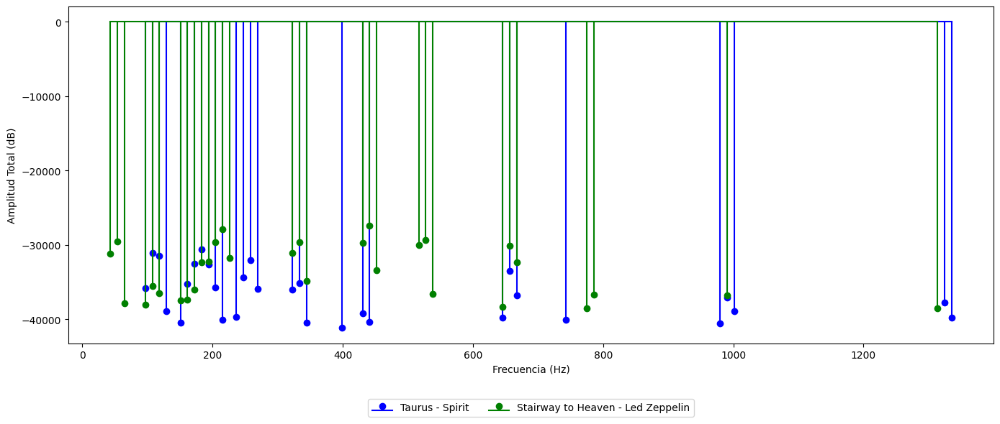

In [23]:
Grafica_frecuencias(audio_Spirit, sr_Spirit, audio_Stairway, sr_Stairway, 'Taurus - Spirit', 'Stairway to Heaven - Led Zeppelin')

In [24]:
alpha = 0.05
prueba_media(audio_Spirit, audio_Stairway, alpha)
prueba_varianza(audio_Spirit, audio_Stairway, alpha)
analizar_mfcc(audio_Spirit, sr_Spirit, audio_Stairway, sr_Stairway, alpha)

T-statistic: 359.1321220030492
P-value: 0.0
Hay una diferencia significativa en las amplitudes medias de las dos canciones.
Estadístico de Levene: 83690.27118502144
P-valor: 0.0
Las varianzas de las amplitudes son significativamente diferentes.
MFCC 1: T-statistic: 52.00444628829989, P-value: 0.0
MFCC 1: Hay una diferencia significativa.
MFCC 2: T-statistic: -39.435192174036956, P-value: 2.275329927898675e-226
MFCC 2: Hay una diferencia significativa.
MFCC 3: T-statistic: 9.328573540127774, P-value: 3.04395965995088e-20
MFCC 3: Hay una diferencia significativa.
MFCC 4: T-statistic: 25.913807066893266, P-value: 9.077655178597554e-127
MFCC 4: Hay una diferencia significativa.
MFCC 5: T-statistic: -10.367532235636903, P-value: 1.5032028251406604e-24
MFCC 5: Hay una diferencia significativa.
MFCC 6: T-statistic: 6.72231585481002, P-value: 2.4172128344112317e-11
MFCC 6: Hay una diferencia significativa.
MFCC 7: T-statistic: -5.154282626441739, P-value: 2.790472496049319e-07
MFCC 7: Hay una 

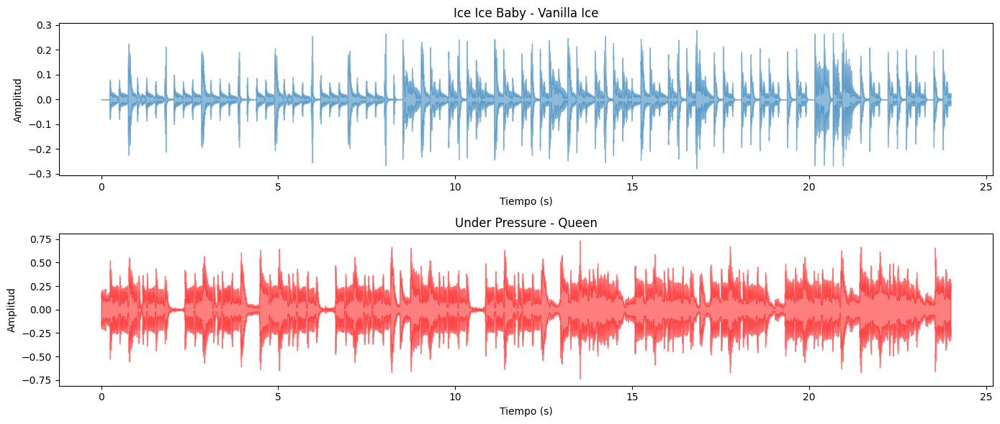

In [25]:
Grafica_Amplitud(audio_IceIce, sr_IceIce, audio_UnderPressure, sr_UnderPressure, 'Ice Ice Baby - Vanilla Ice', 'Under Pressure - Queen')

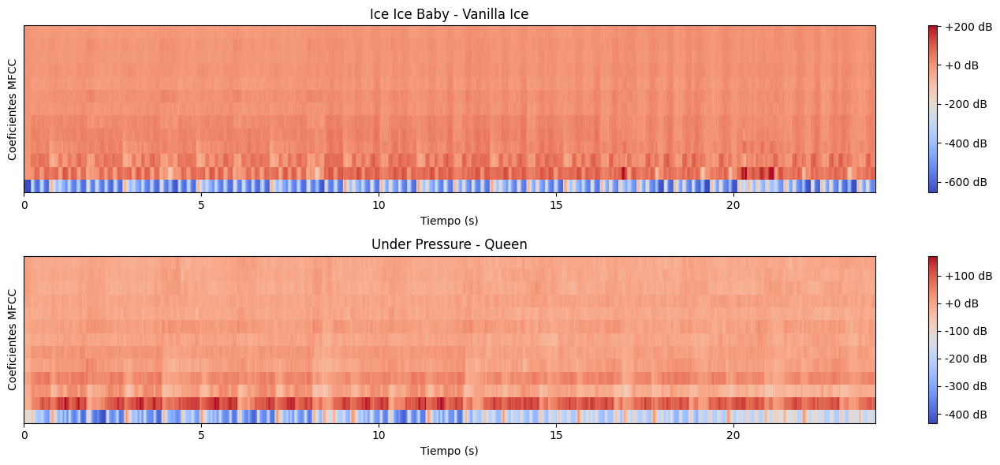

In [26]:
Grafica_MFCC(audio_IceIce, sr_IceIce, audio_UnderPressure, sr_UnderPressure, 'Ice Ice Baby - Vanilla Ice', 'Under Pressure - Queen')

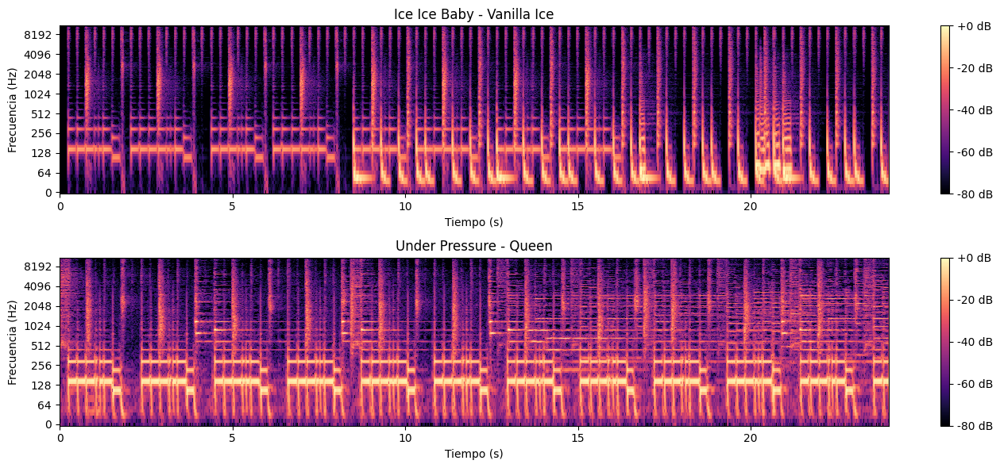

In [27]:
Grafica_Espectograma(audio_IceIce, sr_IceIce, audio_UnderPressure, sr_UnderPressure, 'Ice Ice Baby - Vanilla Ice', 'Under Pressure - Queen')

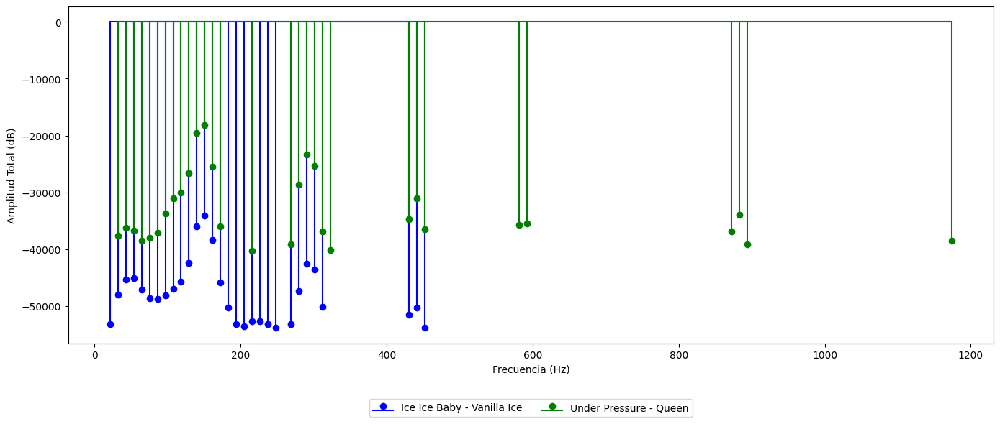

In [28]:
Grafica_frecuencias(audio_IceIce, sr_IceIce, audio_UnderPressure, sr_UnderPressure, 'Ice Ice Baby - Vanilla Ice', 'Under Pressure - Queen')

In [29]:
alpha = 0.05
prueba_media(audio_IceIce, audio_UnderPressure, alpha)
prueba_varianza(audio_IceIce, audio_UnderPressure, alpha)
analizar_mfcc(audio_IceIce, sr_IceIce, audio_UnderPressure, sr_UnderPressure, alpha)

T-statistic: -619.0594252164776
P-value: 0.0
Hay una diferencia significativa en las amplitudes medias de las dos canciones.
Estadístico de Levene: 331764.29320613696
P-valor: 0.0
Las varianzas de las amplitudes son significativamente diferentes.
MFCC 1: T-statistic: -37.286791806058766, P-value: 8.835656540027678e-225
MFCC 1: Hay una diferencia significativa.
MFCC 2: T-statistic: -16.61928230433458, P-value: 4.301533439400027e-58
MFCC 2: Hay una diferencia significativa.
MFCC 3: T-statistic: 21.824718123399997, P-value: 3.369411559911768e-94
MFCC 3: Hay una diferencia significativa.
MFCC 4: T-statistic: -17.887779892558413, P-value: 1.2050488437028166e-66
MFCC 4: Hay una diferencia significativa.
MFCC 5: T-statistic: 23.59705315182605, P-value: 6.019195760058823e-109
MFCC 5: Hay una diferencia significativa.
MFCC 6: T-statistic: 11.593277645322983, P-value: 4.296828868745853e-30
MFCC 6: Hay una diferencia significativa.
MFCC 7: T-statistic: 7.042286967673303, P-value: 2.59631694537855